<a href="https://colab.research.google.com/github/Vrinda-Agarwal/head-pose-estimation/blob/main/head_pose_estimation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Set a higher data rate limit (e.g., 10 MB/s)
%config InlineBackend.figure_format = 'retina'
%matplotlib inline
import matplotlib.pyplot as plt

# Increase the data rate limit
import IPython
IPython.display.data_rate_limit = 10000000


In [ ]:
!pip install mediapipe

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.5/34.5 MB 20.2 MB/s eta 0:00:00


In [ ]:
!wget -q -O detector.tflite -q https://storage.googleapis.com/mediapipe-models/face_detector/blaze_face_short_range/float16/1/blaze_face_short_range.tflite

In [ ]:
from typing import Tuple, Union
import math
import cv2
import numpy as np

MARGIN = 10  # pixels
ROW_SIZE = 10  # pixels
FONT_SIZE = 1
FONT_THICKNESS = 1
TEXT_COLOR = (255, 0, 0)  # red


def _normalized_to_pixel_coordinates(
    normalized_x: float, normalized_y: float, image_width: int,
    image_height: int) -> Union[None, Tuple[int, int]]:
  """Converts normalized value pair to pixel coordinates."""

  # Checks if the float value is between 0 and 1.
  def is_valid_normalized_value(value: float) -> bool:
    return (value > 0 or math.isclose(0, value)) and (value < 1 or
                                                      math.isclose(1, value))

  if not (is_valid_normalized_value(normalized_x) and
          is_valid_normalized_value(normalized_y)):
    # TODO: Draw coordinates even if it's outside of the image bounds.
    return None
  x_px = min(math.floor(normalized_x * image_width), image_width - 1)
  y_px = min(math.floor(normalized_y * image_height), image_height - 1)
  return x_px, y_px


def visualize(
    image,
    detection_result
) -> np.ndarray:
  """Draws bounding boxes and keypoints on the input image and return it.
  Args:
    image: The input RGB image.
    detection_result: The list of all "Detection" entities to be visualize.
  Returns:
    Image with bounding boxes.
  """
  annotated_image = image.copy()
  height, width, _ = image.shape

  for detection in detection_result.detections:
    # Draw bounding_box
    bbox = detection.bounding_box
    start_point = bbox.origin_x, bbox.origin_y
    end_point = bbox.origin_x + bbox.width, bbox.origin_y + bbox.height
    cv2.rectangle(annotated_image, start_point, end_point, TEXT_COLOR, 3)

    # Draw keypoints
    for keypoint in detection.keypoints:
      keypoint_px = _normalized_to_pixel_coordinates(keypoint.x, keypoint.y,
                                                     width, height)
      color, thickness, radius = (0, 255, 0), 2, 2
      cv2.circle(annotated_image, keypoint_px, thickness, color, radius)

    # Draw label and score
    category = detection.categories[0]
    category_name = category.category_name
    category_name = '' if category_name is None else category_name
    probability = round(category.score, 2)
    result_text = category_name + ' (' + str(probability) + ')'
    text_location = (MARGIN + bbox.origin_x,
                     MARGIN + ROW_SIZE + bbox.origin_y)
    cv2.putText(annotated_image, result_text, text_location, cv2.FONT_HERSHEY_PLAIN,
                FONT_SIZE, TEXT_COLOR, FONT_THICKNESS)

  return annotated_image

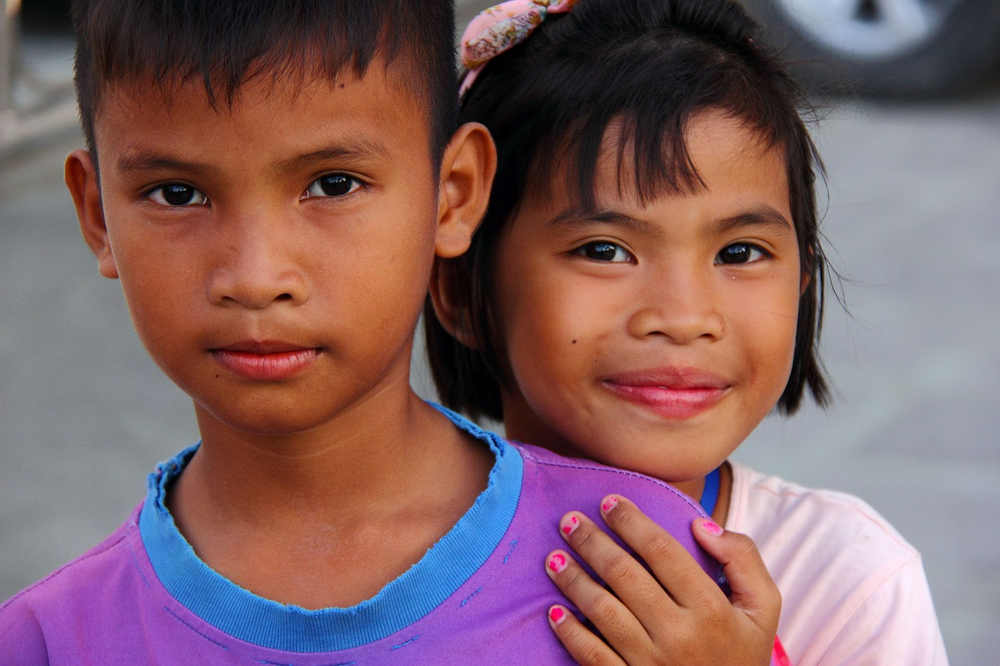

In [ ]:
!wget -q -O image.jpg https://i.imgur.com/Vu2Nqwb.jpg

IMAGE_FILE = 'image.jpg'

import cv2
from google.colab.patches import cv2_imshow

img = cv2.imread(IMAGE_FILE)
cv2_imshow(img)

In [ ]:
# STEP 1: Import the necessary modules.
import numpy as np
import mediapipe as mp
from mediapipe.tasks import python
from mediapipe.tasks.python import vision

# STEP 2: Create an FaceDetector object.
base_options = python.BaseOptions(model_asset_path='detector.tflite')
options = vision.FaceDetectorOptions(base_options=base_options)
detector = vision.FaceDetector.create_from_options(options)

# STEP 3: Load the input image.
image = mp.Image.create_from_file(IMAGE_FILE)

# STEP 4: Detect faces in the input image.
detection_result = detector.detect(image)

# STEP 5: Process the detection result. In this case, visualize it.
image_copy = np.copy(image.numpy_view())
annotated_image = visualize(image_copy, detection_result)
rgb_annotated_image = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
# cv2_imshow(rgb_annotated_image)

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
from typing import List, Tuple, Union
import math
import cv2
import numpy as np

MARGIN = 10  # pixels
ROW_SIZE = 10  # pixels
FONT_SIZE = 1
FONT_THICKNESS = 1
TEXT_COLOR = (255, 0, 0)  # red


def _normalized_to_pixel_coordinates(
    normalized_x: float, normalized_y: float, image_width: int,
    image_height: int) -> Union[None, Tuple[int, int]]:
    """Converts normalized value pair to pixel coordinates."""
    def is_valid_normalized_value(value: float) -> bool:
        return (value > 0 or math.isclose(0, value)) and (value < 1 or
                                                          math.isclose(1, value))

    if not (is_valid_normalized_value(normalized_x) and
            is_valid_normalized_value(normalized_y)):
        return None
    x_px = min(math.floor(normalized_x * image_width), image_width - 1)
    y_px = min(math.floor(normalized_y * image_height), image_height - 1)
    return x_px, y_px


def visualize(image, detection_result) -> Tuple[np.ndarray, List[List[Tuple[int, int]]]]:
    """Draws bounding boxes and keypoints on the input image and returns it along with keypoints.
    Args:
        image: The input RGB image.
        detection_result: The list of all "Detection" entities to be visualized.
    Returns:
        Image with bounding boxes and a list of keypoints for each face.
    """
    annotated_image = image.copy()
    height, width, _ = image.shape

    keypoints_list = []  # List to store keypoints for each face

    for detection in detection_result.detections:
        # Draw bounding_box
        bbox = detection.bounding_box
        start_point = bbox.origin_x, bbox.origin_y
        end_point = bbox.origin_x + bbox.width, bbox.origin_y + bbox.height
        cv2.rectangle(annotated_image, start_point, end_point, TEXT_COLOR, 3)

        # Draw keypoints
        keypoints_for_face = []
        for keypoint in detection.keypoints:
            keypoint_px = _normalized_to_pixel_coordinates(keypoint.x, keypoint.y,
                                                           width, height)
            keypoints_for_face.append(keypoint_px)
            color, thickness, radius = (0, 255, 0), 2, 2
            cv2.circle(annotated_image, keypoint_px, thickness, color, radius)

        keypoints_list.append(keypoints_for_face)

        # Draw label and score
        category = detection.categories[0]
        category_name = category.category_name
        category_name = '' if category_name is None else category_name
        probability = round(category.score, 2)
        result_text = category_name + ' (' + str(probability) + ')'
        text_location = (MARGIN + bbox.origin_x,
                         MARGIN + ROW_SIZE + bbox.origin_y)
        cv2.putText(annotated_image, result_text, text_location, cv2.FONT_HERSHEY_PLAIN,
                    FONT_SIZE, TEXT_COLOR, FONT_THICKNESS)

    return annotated_image, keypoints_list


# Example usage:
# annotated_image, keypoints_list = visualize(input_image, face_detection_result)
# Display or save the annotated_image, and use keypoints_list as needed.


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import skimage
from skimage import transform
from sklearn.preprocessing import LabelEncoder
from sklearn.utils import class_weight
import keras
from keras.utils import to_categorical,Sequence
from keras import applications
from keras.preprocessing import image
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential, Model
from keras.layers import Dropout, Flatten, Dense, GlobalAveragePooling2D,Input,MaxPooling2D,Conv2D,BatchNormalization,Activation
from keras import backend as k
from keras.callbacks import ModelCheckpoint, LearningRateScheduler, TensorBoard, EarlyStopping
from keras.applications import resnet50, inception_resnet_v2, vgg16
from keras.applications.inception_resnet_v2 import preprocess_input
from keras import optimizers
from keras.optimizers import Adam,SGD
import os
from imutils import face_utils
import dlib
import cv2
import tarfile
import cv2
def to_rgb(img):
  return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
import math

In [ ]:
# !pip install -U -q PyDrive
# !git clone https://github.com/Joshua1989/python_scientific_computing.git
# !git clone https://gist.github.com/dc7e60aa487430ea704a8cb3f2c5d6a6.git /tmp/colab_util_repo
# !mv /tmp/colab_util_repo/colab_util.py colab_util.py
# !rm -r /tmp/colab_util_repo

# from colab_util import *
# drive_handler = GoogleDriveHandler()

In [ ]:
!wget https://data.vision.ee.ethz.ch/cvl/gfanelli/downloads/db_annotations.tgz

--2024-02-08 09:56:51--  https://data.vision.ee.ethz.ch/cvl/gfanelli/downloads/db_annotations.tgz
Resolving data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)... 129.132.52.178, 2001:67c:10ec:36c2::178
Connecting to data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)|129.132.52.178|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 565563 (552K) [application/x-gzip]
Saving to: ‘db_annotations.tgz’

db_annotations.tgz  100%[===================>] 552.31K  1.02MB/s    in 0.5s    

2024-02-08 09:56:53 (1.02 MB/s) - ‘db_annotations.tgz’ saved [565563/565563]



In [ ]:
tf = tarfile.open("gdrive/My Drive/kinect_head_pose_db.tgz")
tf.extractall()

In [ ]:
from os import walk
DATASET_PATH = 'hpdb'
def Loading_filepath(PATH):
    '''
    File directory generator.

    ---INPUT---

    PATH --- Directory to the dataset

    ---OUTPUT---

    jpgs --- list of path to images

    ** Made for loading BIWI dataset **

    '''
    jpgs = []
    for (dirpath,dirnames,filenames) in walk(PATH):
        for filename in filenames[:]:
            if(filename[-3:]=='png'):
                jpgs.append(dirpath+"/"+filename)
    return jpgs

In [ ]:
!rm -r 'hpdb/01/frame_00003_rgb.png'

In [ ]:
jpg_path = Loading_filepath(DATASET_PATH)
print("Dataset size: ",len(jpg_path))

Dataset size:  15677


In [ ]:
pose = []
for i in range(len(jpg_path)):
    pose.append("annotations"+jpg_path[i][4:-7]+"pose.bin")
print("Pose parameter size: ",len(pose))

Pose parameter size:  15677


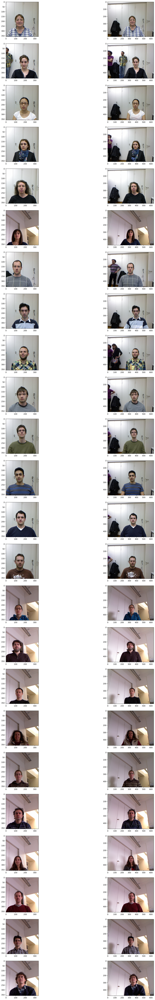

In [ ]:
w=10
h=10
fig=plt.figure(figsize=(20, 100))
columns = 2
rows = 24
j = 1
k = 1
for i in range(1, columns*rows +1):
    if i%2 == 0:
        img = plt.imread("hpdb/" + "{:02d}".format(j) + "/frame_00005_rgb.png")
        j+=1
    else:
        img = plt.imread("hpdb/" + "{:02d}".format(k) + "/frame_00005_rgb.png")[65:-55,200:540]
        k+=1
    fig.add_subplot(rows, columns, i)
    plt.imshow(img,cmap = 'gray')
plt.show()

In [ ]:
import os

DATASET_PATH = 'hpdb'  # Assuming the BIWI dataset is in this directory

def load_images(dataset_path):
    """
    Loads image paths from the specified dataset directory.

    Args:
        dataset_path (str): Path to the dataset directory.

    Returns:
        list: List of image paths.
    """

    image_paths = []
    for root, _, files in os.walk(dataset_path):
        for file in files:
            if file.endswith('.png'):  # Ensure only PNG images are loaded
                image_paths.append(os.path.join(root, file))
    return image_paths

image_paths = load_images(DATASET_PATH)
print("Number of images in the dataset:", len(image_paths))


Number of images in the dataset: 15677


In [ ]:
# import numpy as np
# import mediapipe as mp
# from mediapipe.tasks import python
# from mediapipe.tasks.python import vision

# # STEP 2: Create an FaceDetector object.
# base_options = python.BaseOptions(model_asset_path='detector.tflite')
# options = vision.FaceDetectorOptions(base_options=base_options)
# detector = vision.FaceDetector.create_from_options(options)

# # STEP 3: Load the input image.
# for image_path in image_paths:
#     # Load the image
#     image = mp.Image.create_from_file(image_path)
#     # image = cv2.imread(image_path)

#     # Convert the image to RGB format (if needed)
#     # image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# # STEP 4: Detect faces in the input image.
#     detection_result = detector.detect(image)

# # STEP 5: Process the detection result. In this case, visualize it.
#     image_copy = np.copy(image.numpy_view())
#     annotated_image = visualize(image_copy, detection_result)
#     rgb_annotated_image = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
#     cv2_imshow(rgb_annotated_image)

In [ ]:
tf = tarfile.open("gdrive/My Drive/db_annotations.tar")
tf.extractall()

In [ ]:
# # annotated_image, keypoints_list = visualize(input_image, face_detection_result)
# import numpy as np
# import mediapipe as mp
# from mediapipe.tasks import python
# from mediapipe.tasks.python import vision

# # STEP 2: Create an FaceDetector object.
# base_options = python.BaseOptions(model_asset_path='detector.tflite')
# options = vision.FaceDetectorOptions(base_options=base_options)
# detector = vision.FaceDetector.create_from_options(options)
# keypoints_list=[]
# # STEP 3: Load the input image.
# for image_path in image_paths:
#     # Load the image
#     image = mp.Image.create_from_file(image_path)
#     # image = cv2.imread(image_path)

#     # Convert the image to RGB format (if needed)
#     # image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# # STEP 4: Detect faces in the input image.
#     detection_result = detector.detect(image)

# # STEP 5: Process the detection result. In this case, visualize it.
#     image_copy = np.copy(image.numpy_view())
#     annotated_image,keypoints_list = visualize(image_copy, detection_result)
#     rgb_annotated_image = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
#     cv2_imshow(rgb_annotated_image)


In [ ]:
# import numpy as np
# import mediapipe as mp
# from mediapipe.tasks import python
# from mediapipe.tasks.python import vision

# # STEP 2: Create a FaceDetector object.
# base_options = python.BaseOptions(model_asset_path='detector.tflite')
# options = vision.FaceDetectorOptions(base_options=base_options)
# detector = vision.FaceDetector.create_from_options(options)

# keypoints_list_all_images = []  # List to store keypoints for all images

# # STEP 3: Load and process each input image.
# for image_path in image_paths:
#     # Load the image
#     image = mp.Image.create_from_file(image_path)

#     # Detect faces in the input image.
#     detection_result = detector.detect(image)

#     # Process the detection result and visualize it.
#     image_copy = np.copy(image.numpy_view())
#     annotated_image, keypoints = visualize(image_copy, detection_result)

#     # Append keypoints to the list for all images
#     keypoints_list_all_images.append(keypoints)

#     # Optionally, display the annotated image
#     rgb_annotated_image = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
#     cv2_imshow(rgb_annotated_image)

# # Now keypoints_list_all_images contains the keypoints for all images in the dataset

In [ ]:
import os
import cv2

# ... (previous code)
keypoints_list_all_images = []  # List to store keypoints for all images
# Folder to save annotated images
output_folder = "annotated_images"
os.makedirs(output_folder, exist_ok=True)

# Process and save each input image
for idx, image_path in enumerate(image_paths):
    # Load the image
    image = mp.Image.create_from_file(image_path)

    # Detect faces in the input image.
    detection_result = detector.detect(image)

    # Process the detection result and visualize it.
    image_copy = np.copy(image.numpy_view())
    annotated_image, keypoints = visualize(image_copy, detection_result)

    # Save the annotated image to the output folder
    output_path = os.path.join(output_folder, f"annotated_image_{idx}.jpg")
    cv2.imwrite(output_path, annotated_image)

    # Append keypoints to the list for all images
    keypoints_list_all_images.append(keypoints)

# Display a message indicating the completion of the processing
print("Processing completed. Annotated images saved in the 'annotated_images' folder.")


Processing completed. Annotated images saved in the 'annotated_images' folder.


In [ ]:
# print(keypoints_list_all_images)

In [ ]:
# from google.colab import drive
# import tarfile
# import os
# import struct
# tar_path = '/content/gdrive/My Drive/db_annotations.tar'
# extracted_folder = '/content/annotations'  # Choose a path for extraction

# with tarfile.open(tar_path, 'r') as tf:
#     tf.extractall(path=extracted_folder)

# # Step 3: Read the .bin files and load ground truth
# ground_truth = {}

# for folder_name in os.listdir(extracted_folder):
#     folder_path = os.path.join(extracted_folder, folder_name)

#     if os.path.isdir(folder_path):
#         for bin_file_name in os.listdir(folder_path):
#             if bin_file_name.endswith('.bin'):
#                 bin_file_path = os.path.join(folder_path, bin_file_name)

#                 with open(bin_file_path, 'rb') as bin_file:
#                     # Assuming each .bin file contains 24 float values representing keypoints
#                     keypoints = struct.unpack('f' * 24, bin_file.read())

#                     # Store the keypoints in the ground_truth dictionary
#                     image_id = bin_file_name.split('.')[0]  # Assuming image_id is the file name without extension
#                     ground_truth[image_id] = keypoints

# # Now, the ground_truth dictionary contains the keypoints for each image.
# # You can use this information to compare with your predictions.


In [ ]:
import struct
file_path = '/content/gdrive/My Drive/db_annotations/01/frame_00005_pose.bin'
pose_annotations = []
with open(file_path, 'rb') as file:
    while True:
        # Reading 4 bytes (size of a float in Python) at a time
        bytes_read = file.read(4)
        if not bytes_read:
            break
        # Unpacking the bytes to a float
        float_value = struct.unpack('f', bytes_read)[0]
        pose_annotations.append(float_value)
print(pose_annotations)

[51.76070022583008, 38.50090026855469, 881.8060302734375, -7.578725337982178, 3.3790345191955566, -2.408475160598755]


In [ ]:
import os
import struct

parent_directory = '/content/gdrive/My Drive/db_annotations'
all_pose_annotations = []

# Iterate over all folders (01 to 24)
for folder_num in range(1, 25):
    folder_path = os.path.join(parent_directory, f'{folder_num:02d}')

    # Check if the folder exists
    if os.path.exists(folder_path):
        # Iterate over all files in the directory
        for filename in os.listdir(folder_path):
            if filename.endswith(".bin"):
                file_path = os.path.join(folder_path, filename)

                with open(file_path, 'rb') as file:
                    pose_annotations_per_file = []
                    while True:
                        # Reading 4 bytes (size of a float in Python) at a time
                        bytes_read = file.read(4)
                        if not bytes_read:
                            break
                        # Unpacking the bytes to a float
                        float_value = struct.unpack('f', bytes_read)[0]
                        pose_annotations_per_file.append(float_value)

                # Append pose annotations of the current file to the overall list
                all_pose_annotations.append(pose_annotations_per_file)

# print(all_pose_annotations)


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
# Filter out empty lists
non_empty_keypoints = [image[0] for image in keypoints_list_all_images if image]

# Convert keypoints to PyTorch tensor
keypoints_tensor = torch.tensor([[[point[0], point[1]] for point in image] for image in non_empty_keypoints], dtype=torch.float32)

# Convert pose annotations to PyTorch tensor
pose_annotations_tensor = torch.tensor(all_pose_annotations, dtype=torch.float32)

# Verify the shapes
print("Keypoints Tensor Shape:", keypoints_tensor.shape)
print("Pose Annotations Tensor Shape:", pose_annotations_tensor.shape)

Keypoints Tensor Shape: torch.Size([14123, 6, 2])
Pose Annotations Tensor Shape: torch.Size([15677, 6])


In [ ]:
# # basic working MLP
# import torch
# import torch.nn as nn
# import torch.optim as optim
# from torch.utils.data import DataLoader, TensorDataset

# min_samples = min(keypoints_tensor.size(0), pose_annotations_tensor.size(0))
# # Truncate both tensors to have the same number of samples
# keypoints_tensor = keypoints_tensor[:min_samples]
# pose_annotations_tensor = pose_annotations_tensor[:min_samples]

# # Verify the shapes again
# print("Keypoints Tensor Shape:", keypoints_tensor.shape)
# print("Labels Tensor Shape:", pose_annotations_tensor.shape)


# # Define the MLP-based model
# class MLPModel(nn.Module):
#     def __init__(self, input_size, hidden_size, output_size):
#         super(MLPModel, self).__init__()
#         self.fc1 = nn.Linear(input_size, hidden_size)
#         self.relu1 = nn.ReLU()
#         self.fc2 = nn.Linear(hidden_size, hidden_size)
#         self.relu2 = nn.ReLU()
#         self.fc3 = nn.Linear(hidden_size, output_size)

#     def forward(self, x):
#         x = self.fc1(x)
#         x = self.relu1(x)
#         x = self.fc2(x)
#         x = self.relu2(x)
#         x = self.fc3(x)
#         return x


# # Set parameters
# input_size = 12  # Dimensionality of each input vector
# hidden_size = 30  # Size of hidden layers
# output_size = 6  # Size of the output (adjust according to your task)

# # Instantiate the model
# model = MLPModel(input_size, hidden_size, output_size)

# # Define loss function, optimizer, and other training parameters
# criterion = nn.MSELoss()  # Assuming a regression task, change this based on your task
# optimizer = optim.Adam(model.parameters(), lr=0.00001, weight_decay=0.0001)
# epochs = 500
# batch_size = 64

# # Create DataLoader for batch processing
# dataset = TensorDataset(keypoints_tensor, pose_annotations_tensor)
# dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
# # Reshape keypoints tensor
# keypoints_tensor_flat = keypoints_tensor.view(-1, input_size)

# # Verify the new shape
# print("Reshaped Keypoints Tensor Shape:", keypoints_tensor_flat.shape)

# # ... rest of your code remains unchanged ...

# # Training loop
# for epoch in range(epochs):
#     for batch_input, batch_labels in dataloader:
#         optimizer.zero_grad()

#         # Reshape input tensor before passing it through the model
#         batch_input_flat = batch_input.view(-1, input_size)

#         predictions = model(batch_input_flat)
#         loss = criterion(predictions, batch_labels)
#         loss.backward()
#         optimizer.step()

#     if (epoch + 1) % 10 == 0:
#         print(f'Epoch [{epoch + 1}/{epochs}], Loss: {loss.item()}')

# # # Training loop
# # for epoch in range(epochs):
# #     for batch_input, batch_labels in dataloader:
# #         optimizer.zero_grad()
# #         predictions = model(batch_input)
# #         loss = criterion(predictions, batch_labels)
# #         loss.backward()
# #         optimizer.step()

# #     if (epoch + 1) % 10 == 0:
# #         print(f'Epoch [{epoch + 1}/{epochs}], Loss: {loss.item()}')

# # Now, the model is trained on your keypoints data
# # You can use the trained model for predictions on new data

In [ ]:
# per sample loss
# import torch
# import torch.nn as nn
# import torch.optim as optim
# from torch.utils.data import DataLoader, TensorDataset

min_samples = min(keypoints_tensor.size(0), pose_annotations_tensor.size(0))
# Truncate both tensors to have the same number of samples
keypoints_tensor = keypoints_tensor[:min_samples]
pose_annotations_tensor = pose_annotations_tensor[:min_samples]

# Verify the shapes again
print("Keypoints Tensor Shape:", keypoints_tensor.shape)
print("Labels Tensor Shape:", pose_annotations_tensor.shape)


# # Define the MLP-based model
class MLPModel(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(MLPModel, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_size)
        self.relu1 = nn.ReLU()
        self.fc2 = nn.Linear(hidden_size, hidden_size)
        self.relu2 = nn.ReLU()
        self.fc3 = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        x = self.fc1(x)
        x = self.relu1(x)
        x = self.fc2(x)
        x = self.relu2(x)
        x = self.fc3(x)
        return x


# Set parameters
input_size = 12  # Dimensionality of each input vector
hidden_size = 30  # Size of hidden layers
output_size = 6  # Size of the output (adjust according to your task)

# Instantiate the model
model = MLPModel(input_size, hidden_size, output_size)

# Define loss function, optimizer, and other training parameters
criterion = nn.MSELoss()  # Assuming a regression task, change this based on your task
optimizer = optim.Adam(model.parameters(), lr=0.00001, weight_decay=0.0001)
epochs = 500
batch_size = 64

# Create DataLoader for batch processing
dataset = TensorDataset(keypoints_tensor, pose_annotations_tensor)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
# Reshape keypoints tensor
keypoints_tensor_flat = keypoints_tensor.view(-1, input_size)

# Verify the new shape
print("Reshaped Keypoints Tensor Shape:", keypoints_tensor_flat.shape)

# # Training loop

# # Training loop
# for epoch in range(epochs):
#     for batch_input, batch_labels in dataloader:
#         optimizer.zero_grad()

#         # Reshape input tensor before passing it through the model
#         batch_input_flat = batch_input.view(-1, input_size)

#         predictions = model(batch_input_flat)
#         loss = criterion(predictions, batch_labels)

#         # Print or log the loss for each sample in the batch
#         print(f'Sample Loss: {loss.item()/14123}')

#         loss.backward()
#         optimizer.step()

#     if (epoch + 1) % 10 == 0:
#         print(f'Epoch [{epoch + 1}/{epochs}], Average Loss: {loss.item()}')


# # # Training loop
# # for epoch in range(epochs):
# #     for batch_input, batch_labels in dataloader:
# #         optimizer.zero_grad()
# #         predictions = model(batch_input)
# #         loss = criterion(predictions, batch_labels)
# #         loss.backward()
# #         optimizer.step()

# #     if (epoch + 1) % 10 == 0:
# #         print(f'Epoch [{epoch + 1}/{epochs}], Loss: {loss.item()}')

# # Now, the model is trained on your keypoints data
# # You can use the trained model for predictions on new data

Keypoints Tensor Shape: torch.Size([14123, 6, 2])
Labels Tensor Shape: torch.Size([14123, 6])
Reshaped Keypoints Tensor Shape: torch.Size([14123, 12])


In [ ]:
# from tabulate import tabulate
# import torch
# import torch.nn as nn
# import torch.optim as optim
# from torch.utils.data import DataLoader, TensorDataset

# # ... (Previous code for data loading, model definition, etc.)

# # Lists to store results
# methods = ["MLP with location (Ours)"]
# yaw_mae_results = []
# pitch_mae_results = []
# roll_mae_results = []
# epochs = 500
# # Training loop
# for epoch in range(epochs):
#     for batch_input, batch_labels in dataloader:
#         optimizer.zero_grad()

#         # Reshape input tensor before passing it through the model
#         batch_input_flat = batch_input.view(-1, input_size)

#         predictions = model(batch_input_flat)
#         loss = criterion(predictions, batch_labels)

#         # Calculate MAE for each sample
#         mae_per_sample = torch.abs(predictions - batch_labels)

#         # Calculate mean MAE for the batch
#         yaw_mae_batch = torch.mean(mae_per_sample[:, 0])
#         pitch_mae_batch = torch.mean(mae_per_sample[:, 1])
#         roll_mae_batch = torch.mean(mae_per_sample[:, 2])

#         # Append results for each method
#         yaw_mae_results.append(yaw_mae_batch.item())
#         pitch_mae_results.append(pitch_mae_batch.item())
#         roll_mae_results.append(roll_mae_batch.item())

#         loss.backward()
#         optimizer.step()

#     if (epoch + 1) % 10 == 0:
#         print(f'Epoch [{epoch + 1}/{epochs}], Average Loss: {loss.item()}')

# # Display results in a table
# results_table = {
#     "Method": methods,
#     "Yaw MAE": yaw_mae_results,
#     "Pitch MAE": pitch_mae_results,
#     "Roll MAE": roll_mae_results
# }

# table_str = tabulate(results_table, headers="keys", tablefmt="grid")
# print(table_str)
# table_str.to_csv("results.csv")

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset

# Lists to store results
methods = ["MLP with location (Ours)"]
yaw_mae_results = []
pitch_mae_results = []
roll_mae_results = []
epochs = 500

# Training loop
for epoch in range(epochs):
    for batch_input, batch_labels in dataloader:
        optimizer.zero_grad()

        # Reshape input tensor before passing it through the model
        batch_input_flat = batch_input.view(-1, input_size)

        predictions = model(batch_input_flat)
        loss = criterion(predictions, batch_labels)

        # Calculate MAE for each sample
        mae_per_sample = torch.abs(predictions - batch_labels)

        # Calculate mean MAE for the batch
        yaw_mae_batch = torch.mean(mae_per_sample[:, 0])
        pitch_mae_batch = torch.mean(mae_per_sample[:, 1])
        roll_mae_batch = torch.mean(mae_per_sample[:, 2])

        # Append results for each method
        yaw_mae_results.append(yaw_mae_batch.item())
        pitch_mae_results.append(pitch_mae_batch.item())
        roll_mae_results.append(roll_mae_batch.item())

        loss.backward()
        optimizer.step()

    if (epoch + 1) % 10 == 0:
        print(f'Epoch [{epoch + 1}/{epochs}], Average Loss: {loss.item()}')
        print(f'  Yaw MAE: {yaw_mae_batch.item()/10}, Pitch MAE: {pitch_mae_batch.item()/10}, Roll MAE: {roll_mae_batch.item()/10}')

# Save results to a CSV file
import csv

with open("results.csv", "w", newline="") as csvfile:
    csvwriter = csv.writer(csvfile)
    csvwriter.writerow(["Method", "Yaw MAE", "Pitch MAE", "Roll MAE"])

    for method, yaw, pitch, roll in zip(methods, yaw_mae_results, pitch_mae_results, roll_mae_results):
        csvwriter.writerow([method, yaw, pitch, roll])


Epoch [10/500], Average Loss: 101102.9140625
  Yaw MAE: 3.9944698333740236, Pitch MAE: 8.073648071289062, Roll MAE: 76.29189453125
Epoch [20/500], Average Loss: 40388.87890625
  Yaw MAE: 3.9740154266357424, Pitch MAE: 7.954846954345703, Roll MAE: 46.59429016113281
Epoch [30/500], Average Loss: 6971.6279296875
  Yaw MAE: 4.825131607055664, Pitch MAE: 5.420082473754883, Roll MAE: 13.241546630859375
Epoch [40/500], Average Loss: 6331.58251953125
  Yaw MAE: 3.801015853881836, Pitch MAE: 6.390985107421875, Roll MAE: 13.35045928955078
Epoch [50/500], Average Loss: 4700.919921875
  Yaw MAE: 5.1417236328125, Pitch MAE: 5.836895751953125, Roll MAE: 10.742652893066406
Epoch [60/500], Average Loss: 4041.32421875
  Yaw MAE: 4.677430725097656, Pitch MAE: 4.458601760864258, Roll MAE: 9.976158142089844
Epoch [70/500], Average Loss: 4800.38427734375
  Yaw MAE: 4.059354400634765, Pitch MAE: 6.106861877441406, Roll MAE: 11.399406433105469
Epoch [80/500], Average Loss: 5008.53662109375
  Yaw MAE: 4.41267

In [ ]:
# import tarfile
# import struct
# import os

# # Mount Google Drive if not already mounted
# from google.colab import drive
# drive.mount('/content/gdrive')

# # Define the paths
# tar_file_path = '/content/gdrive/My Drive/db_annotations.tar'
# extracted_folder = '/content/gdrive/My Drive/db_annotations'

# # Step 1: Extract the contents of the tar file
# with tarfile.open(tar_file_path, 'r') as tf:
#     tf.extractall(path=extracted_folder)


In [ ]:
# # Update the file path based on the extracted folder
# file_path = os.path.join(extracted_folder, '01/frame_00005_pose.bin')

# pose_annotations = []

# try:
#     with open(file_path, 'rb') as file:
#         while True:
#             # Reading 4 bytes (size of a float in Python) at a time
#             bytes_read = file.read(4)
#             if not bytes_read:
#                 break
#             # Unpacking the bytes to a float
#             float_value = struct.unpack('f', bytes_read)[0]
#             pose_annotations.append(float_value)

#     print(pose_annotations)
# except FileNotFoundError:
#     print(f"File not found at: {file_path}")
# except Exception as e:
#     print(f"An error occurred: {e}")

In [ ]:
# print(all_pose_annotations)

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset, random_split
import csv

# Assuming you have defined all necessary components such as model, criterion, optimizer, dataloader, etc.

# Split dataset into train and test sets
dataset_size = len(dataset)
train_size = int(0.8 * dataset_size)
test_size = dataset_size - train_size
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])

train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# Lists to store best scores
best_train_yaw_mae = float('inf')
best_train_pitch_mae = float('inf')
best_train_roll_mae = float('inf')
best_test_yaw_mae = float('inf')
best_test_pitch_mae = float('inf')
best_test_roll_mae = float('inf')

# Training loop
for epoch in range(epochs):
    # Training
    model.train()  # Set the model to training mode
    for batch_input, batch_labels in train_dataloader:
        optimizer.zero_grad()

        # Reshape input tensor before passing it through the model
        batch_input_flat = batch_input.view(-1, input_size)

        predictions = model(batch_input_flat)
        loss = criterion(predictions, batch_labels)

        # Calculate MAE for each sample
        mae_per_sample = torch.abs(predictions - batch_labels)

        # Calculate mean MAE for the batch
        yaw_mae_batch = torch.mean(mae_per_sample[:, 0])
        pitch_mae_batch = torch.mean(mae_per_sample[:, 1])
        roll_mae_batch = torch.mean(mae_per_sample[:, 2])

        # Update best training scores
        if yaw_mae_batch < best_train_yaw_mae:
            best_train_yaw_mae = yaw_mae_batch.item()
        if pitch_mae_batch < best_train_pitch_mae:
            best_train_pitch_mae = pitch_mae_batch.item()
        if roll_mae_batch < best_train_roll_mae:
            best_train_roll_mae = roll_mae_batch.item()

        loss.backward()
        optimizer.step()

    # Testing
    model.eval()  # Set the model to evaluation mode
    with torch.no_grad():
        for batch_input, batch_labels in test_dataloader:
            # Reshape input tensor before passing it through the model
            batch_input_flat = batch_input.view(-1, input_size)

            predictions = model(batch_input_flat)

            # Calculate MAE for each sample
            mae_per_sample = torch.abs(predictions - batch_labels)

            # Calculate mean MAE for the batch
            yaw_mae_batch = torch.mean(mae_per_sample[:, 0])
            pitch_mae_batch = torch.mean(mae_per_sample[:, 1])
            roll_mae_batch = torch.mean(mae_per_sample[:, 2])

            # Update best testing scores
            if yaw_mae_batch < best_test_yaw_mae:
                best_test_yaw_mae = yaw_mae_batch.item()
            if pitch_mae_batch < best_test_pitch_mae:
                best_test_pitch_mae = pitch_mae_batch.item()
            if roll_mae_batch < best_test_roll_mae:
                best_test_roll_mae = roll_mae_batch.item()

    if (epoch + 1) % 10 == 0:
        print(f'Epoch [{epoch + 1}/{epochs}], Train Loss: {loss.item()}')
        print(f'  Train Yaw MAE: {yaw_mae_batch.item()/10}, Train Pitch MAE: {pitch_mae_batch.item()/10}, Train Roll MAE: {roll_mae_batch.item()/10}')
        print(f'  Best Train Scores: Yaw MAE: {best_train_yaw_mae/10}, Pitch MAE: {best_train_pitch_mae/10}, Roll MAE: {best_train_roll_mae/10}')
        print(f'  Test Yaw MAE: {best_test_yaw_mae/10}, Test Pitch MAE: {best_test_pitch_mae/10}, Test Roll MAE: {best_test_roll_mae/10}')

# Print best scores
print("Best Scores:")
print(f"  Best Train Yaw MAE: {best_train_yaw_mae/10}")
print(f"  Best Train Pitch MAE: {best_train_pitch_mae/10}")
print(f"  Best Train Roll MAE: {best_train_roll_mae/10}")
print(f"  Best Test Yaw MAE: {best_test_yaw_mae/10}")
print(f"  Best Test Pitch MAE: {best_test_pitch_mae/10}")
print(f"  Best Test Roll MAE: {best_test_roll_mae/10}")

# Save results to a CSV file
with open("results.csv", "w", newline="") as csvfile:
    csvwriter = csv.writer(csvfile)
    csvwriter.writerow(["Method", "Train Yaw MAE", "Train Pitch MAE", "Train Roll MAE", "Test Yaw MAE", "Test Pitch MAE", "Test Roll MAE"])
    csvwriter.writerow(["MLP with location (Ours)", best_train_yaw_mae/10, best_train_pitch_mae/10, best_train_roll_mae/10, best_test_yaw_mae/10, best_test_pitch_mae/10, best_test_roll_mae/10])


Epoch [10/500], Train Loss: 2714.240234375
  Train Yaw MAE: 4.639524841308594, Train Pitch MAE: 3.900748443603516, Train Roll MAE: 12.531344604492187
  Best Train Scores: Yaw MAE: 3.1156906127929687, Pitch MAE: 3.5253135681152346, Roll MAE: 6.107768630981445
  Test Yaw MAE: 3.5580734252929687, Test Pitch MAE: 3.8176189422607423, Test Roll MAE: 8.005868530273437
Epoch [20/500], Train Loss: 2286.444580078125
  Train Yaw MAE: 4.630315780639648, Train Pitch MAE: 3.8721466064453125, Train Roll MAE: 12.496263122558593
  Best Train Scores: Yaw MAE: 3.0070775985717773, Pitch MAE: 3.5190120697021485, Roll MAE: 6.107768630981445
  Test Yaw MAE: 3.5580734252929687, Test Pitch MAE: 3.8057151794433595, Test Roll MAE: 8.003218078613282
Epoch [30/500], Train Loss: 2873.782470703125
  Train Yaw MAE: 4.641580963134766, Train Pitch MAE: 3.83125, Train Roll MAE: 12.345773315429687
  Best Train Scores: Yaw MAE: 3.0070775985717773, Pitch MAE: 3.5190120697021485, Roll MAE: 6.107768630981445
  Test Yaw MAE: 

In [ ]:
torch.save(model, "weight.pt")